
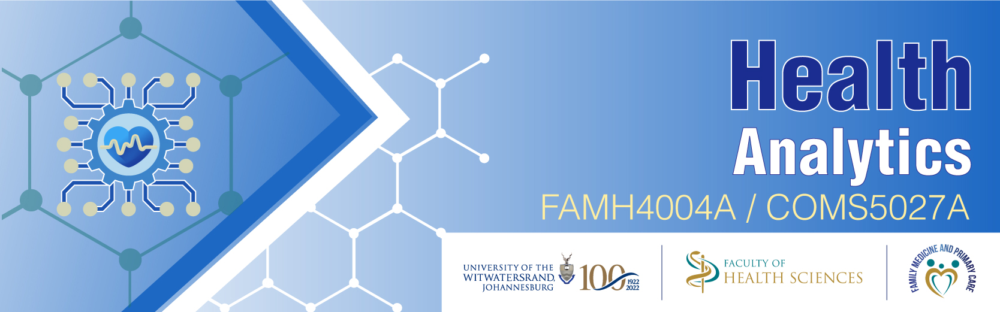


# __Health Analytics: k-Means Clustering and Principal Component Analysis.__
__Name:__ Masixole Boya<br>
__Student number:__ 1869204

***
# __1.Introduction__
***

## __Data dictionary__
### This is a brief description of the dataset, including what columns it has and what they mean.
### The structure of this section is as follows: The column name is on the left of the colon (:) and the column description is on the right. For example, to show that column x means means y, we would show it as "x : y".
<br>
xxxxxx

## __Problem statement__ <br>
### xxxxxx

## __Objective of the analysis__

### The objective of this project is to build and analyse a machine learning model u

## **Table of Contents**
- [Introduction](#1)
  * [Data Dictionary](#2)
  * [Problem statement](#3)
  * [Objective of the analysis](#4)
  * [Table of Contents](#5)


- [Imports](#7)
  * [Importing libraries](#9)
  * [Loading Dataset](#9)
  * [Dataset Overview](#9)
  
- [Exploratory Data Analysis (EDA)](#10)
  * [Dataset Overview (Continued)](#9)
  * [Visualizations](#9)
    * [(i) Univariate Analysis](#9)
    * [Bivariate Analysis](#9)
    * [Correlation Analysis](#9)
  * [Missing Values](#9)
- [Preprocessing](#10)
  * [Removing unecessary columns](#9)

  * [Handling Missing Values](#9)
  * [Feature Engineering](#9)
  * [Encoding Categorical Variables](#9)
  * [Feature Scaling](#9)
  * [Data Splitting](#9)
- [Modelling](#10)
  * [Model Training](#9)
  * [Model Evaluation](#9)
  * [Hyperparameter Tuning](#9)
- [Conclusion](#10)


***
# __2. Imports__
***

## __Importing libraries__

### Here we import the python libraries that we will be using to for all the steps outlined in the table of contents above including EDA, pre-processing, predictive modelling, evaluation and hyper-parameter tuning.

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

## __Dataset Overview__
### This an overview of the dataframe where we see what the data, as described in the "data dictionary" section above, in a tabular format

In [2]:
df = pd.read_excel('C:/Users/STAFF/Desktop/Git_Repos/Health_Analytics/K_Means/FoodAccessResearchAtlasData2019.xlsx', sheet_name="Food Access Research Atlas")

In [3]:
df.head()

,CensusTract,State,County,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,LILATracts_1And10,...,TractSeniors,TractWhite,TractBlack,TractAsian,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP
0,1001020100,Alabama,Autauga County,1,1912,693,0,0.0,0.000000,0,...,221.0,1622.0,217.0,14.0,0.0,14.0,45.0,44.0,6.0,102.0
1,1001020200,Alabama,Autauga County,1,2170,743,0,181.0,8.341014,1,...,214.0,888.0,1217.0,5.0,0.0,5.0,55.0,75.0,89.0,156.0
2,1001020300,Alabama,Autauga County,1,3373,1256,0,0.0,0.000000,0,...,439.0,2576.0,647.0,17.0,5.0,11.0,117.0,87.0,99.0,172.0
3,1001020400,Alabama,Autauga County,1,4386,1722,0,0.0,0.000000,0,...,904.0,4086.0,193.0,18.0,4.0,11.0,74.0,85.0,21.0,98.0
4,1001020500,Alabama,Autauga County,1,10766,4082,0,181.0,1.681219,0,...,1126.0,8666.0,1437.0,296.0,9.0,48.0,310.0,355.0,230.0,339.0


In [4]:
df.shape


(72531, 147)

In [5]:
df.drop(columns=["CensusTract","State","County"],inplace=True)

***
# __3. Dimensionality Reduction through PCA (Principal Component Analysis)__
***

#### Scaling


In [6]:
scaler = StandardScaler()
data_scaled = scaler.fit_transform(df)

In [7]:
print(f"Type of df: {type(df)}")
print(f"Type of the scaled data: {type(data_scaled)}")


Type of df: <class 'pandas.core.frame.DataFrame'>
Type of the scaled data: <class 'numpy.ndarray'>


In [8]:

dF = pd.DataFrame(data_scaled, columns= df.columns)


In [9]:
dF.head()

,Urban,Pop2010,OHU2010,GroupQuartersFlag,NUMGQTRS,PCTGQTRS,LILATracts_1And10,LILATracts_halfAnd10,LILATracts_1And20,LILATracts_Vehicle,...,TractSeniors,TractWhite,TractBlack,TractAsian,TractNHOPI,TractAIAN,TractOMultir,TractHispanic,TractHUNV,TractSNAP
0,0.560986,-1.198758,-1.262544,-0.084647,-0.248061,-0.283014,-0.383344,-0.622294,-0.355549,-0.402818,...,-0.949955,-0.812946,-0.359635,-0.432068,-0.164777,-0.147439,-0.647336,-0.582403,-0.591696,-0.537004
1,0.560986,-1.066854,-1.193643,-0.084647,0.159662,0.588491,2.608622,1.606956,2.812551,-0.402818,...,-0.969853,-1.221552,0.765082,-0.452716,-0.164777,-0.198178,-0.628445,-0.554711,-0.235071,-0.246304
2,0.560986,-0.451815,-0.486711,-0.084647,-0.248061,-0.283014,-0.383344,-0.622294,-0.355549,-0.402818,...,-0.330290,-0.281870,0.123993,-0.425185,-0.054124,-0.164352,-0.511319,-0.543991,-0.192104,-0.160171
3,0.560986,0.066085,0.155454,-0.084647,-0.248061,-0.283014,-0.383344,-0.622294,-0.355549,-0.402818,...,0.991472,0.558723,-0.386629,-0.422891,-0.076254,-0.164352,-0.592551,-0.545778,-0.527246,-0.558537
4,0.560986,3.327887,3.407616,-0.084647,0.159662,-0.107353,-0.383344,-0.622294,-0.355549,-0.402818,...,1.622507,3.108334,1.012520,0.214906,0.034399,0.044243,-0.146718,-0.304591,0.370763,0.738844


#### Missing values

In [10]:
missing_values = dF.isnull().sum()
missing_columns = missing_values[missing_values > 0]

# Calculate the percentage of missing values
missing_percentage =round((missing_columns / len(dF)) * 100,2)

# Combine the missing count and percentage into a DataFrame
missing_info = pd.DataFrame({'Count of Missing Values': missing_columns, 'Percentage of missing values (%)': missing_percentage})

# Sort the DataFrame by the number of missing values in descending order
missing_info_sorted = missing_info.sort_values(by='Count of Missing Values', ascending=False)

print(f"Table showing the count and percentage of missing values from each column:\n {missing_info_sorted}")


Table showing the count and percentage of missing values from each column:
                 Count of Missing Values  Percentage of missing values (%)
lahunv20                          71025                             97.92
lablack20share                    71025                             97.92
lasnap20                          71025                             97.92
lapop20share                      71025                             97.92
lalowi20                          71025                             97.92
...                                 ...                               ...
TractOMultir                          4                              0.01
TractHispanic                         4                              0.01
TractHUNV                             4                              0.01
TractSNAP                             4                              0.01
PovertyRate                           3                              0.00

[126 rows x 2 columns]


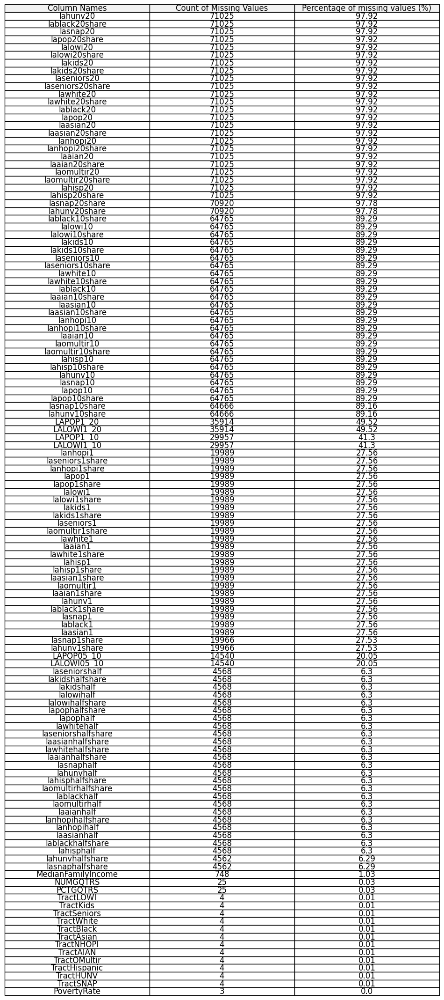

In [11]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming you have 'missing_info_sorted' DataFrame as previously defined

# Create a figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Hide the axes
ax.axis('off')

# Combine the column names with the missing value information
missing_info_combined = pd.DataFrame({'Column Names': missing_info_sorted.index,
                                      'Count of Missing Values': missing_info_sorted['Count of Missing Values'],
                                      'Percentage of missing values (%)': missing_info_sorted['Percentage of missing values (%)']})

# Create a table and add it to the axis
table = ax.table(cellText=missing_info_combined.values, colLabels=missing_info_combined.columns, cellLoc='center', loc='center', colColours=['#f2f2f2'] * (len(missing_info_combined.columns)))

# Style the table
table.auto_set_font_size(False)
table.set_fontsize(12)

# Show the table
plt.show()


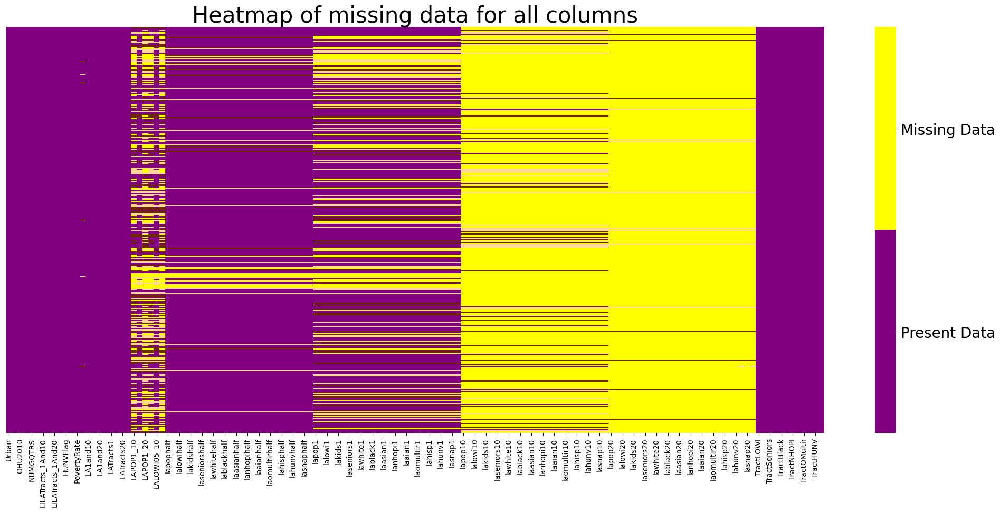

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Create a custom color map with only the desired colors
custom_cmap = mcolors.ListedColormap(['purple', 'yellow'])

# Create a larger figure with a horizontal extension
plt.figure(figsize=(25, 10))

# Create the heatmap with the custom color map
ax = sns.heatmap(dF.isnull(), yticklabels=False, cbar=True, cmap=custom_cmap)

# Customize the color bar
cbar = ax.collections[0].colorbar
cbar.set_ticks([0.25,0.75])  # Only one tick in the middle
cbar.set_ticklabels(['Present Data','Missing Data'],fontsize = 20)

# Add a title
plt.title('Heatmap of missing data for all columns', fontsize= 30)

# Show the heatmap
plt.show()


In [13]:
#xxxxxxxxxxxxxxxx REMOVE 80 xxxxxxxxxxxxxxxxxxxxx
# Define the threshold for removing columns (e.g., 80%)
threshold_percentage = 80

# Filter columns to be removed based on the threshold
columns_to_remove = missing_info_sorted[missing_info_sorted['Percentage of missing values (%)'] > threshold_percentage].index

# Remove the columns from the original DataFrame
dF = dF.drop(columns=columns_to_remove)

#### xxxxxxxxxxx 30 xxxxxxxxxxxx

threshold_percentage_low = 30
for column in dF.columns:
    if column not in columns_to_remove:  # Skip the columns to be removed
        missing_percentage = (dF[column].isnull().sum() / len(dF)) * 100
        if missing_percentage < threshold_percentage_low:
            mode_value = dF[column].mode()[0]  # Calculate the mode
            dF[column].fillna(mode_value, inplace=True)


Table showing the count and percentage of missing values from each column:
             Count of Missing Values  Percentage of missing values (%)
LAPOP1_20                     35914                             49.52
LALOWI1_20                    35914                             49.52
LAPOP1_10                     29957                             41.30
LALOWI1_10                    29957                             41.30


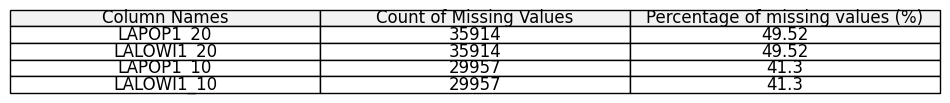

In [14]:
missing_values = dF.isnull().sum()
missing_columns = missing_values[missing_values > 0]

# Calculate the percentage of missing values
missing_percentage =round((missing_columns / len(dF)) * 100,2)

# Combine the missing count and percentage into a DataFrame
missing_info = pd.DataFrame({'Count of Missing Values': missing_columns, 'Percentage of missing values (%)': missing_percentage})

# Sort the DataFrame by the number of missing values in descending order
missing_info_sorted = missing_info.sort_values(by='Count of Missing Values', ascending=False)

print(f"Table showing the count and percentage of missing values from each column:\n {missing_info_sorted}")

fig, ax = plt.subplots(figsize=(12, 1))

# Hide the axes
ax.axis('off')

# Combine the column names with the missing value information
missing_info_combined = pd.DataFrame({'Column Names': missing_info_sorted.index,
                                      'Count of Missing Values': missing_info_sorted['Count of Missing Values'],
                                      'Percentage of missing values (%)': missing_info_sorted['Percentage of missing values (%)']})

# Create a table and add it to the axis
table = ax.table(cellText=missing_info_combined.values, colLabels=missing_info_combined.columns, cellLoc='center', loc='center', colColours=['#f2f2f2'] * (len(missing_info_combined.columns)))

# Style the table
table.auto_set_font_size(False)
table.set_fontsize(12)

# Show the table
plt.show()

#### For these columns, they are in the range of 40-50% of values missing and so I decide to not just delete or just decide what to impute. Instead, I decide to take a look into these columns individually. 

In [15]:

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
# List of columns with high missing values
high_missing_cols = ['LAPOP1_20', 'LALOWI1_20', 'LAPOP1_10', 'LALOWI1_10']

for col in high_missing_cols:
    # Calculate basic statistics for non-missing values
    non_missing_data = dF[col].dropna()
    mean_value = non_missing_data.mean()
    median_value = non_missing_data.median()
    mode_value = non_missing_data.mode()[0]  # Most frequent value
    
    # Count the number of unique values
    unique_count = len(non_missing_data.unique())
    
    # Calculate the percentage of missing values
    missing_percentage = (1 - len(non_missing_data) / len(dF)) * 100
    
    # Calculate summary statistics using describe()
    describe_stats = non_missing_data.describe()
    
    # Print statistics for each column
    print(f"Column: {col}")
    print(f"Number of Unique Values: {unique_count}")
    print(f"Mean: {mean_value}")
    print(f"Median: {median_value}")
    print(f"Mode: {mode_value}")
    print(f"Missing Percentage: {missing_percentage:.2f}%")
    
    # Print additional summary statistics using describe()
    print(describe_stats)
    
    print("-" * 30)


Column: LAPOP1_20
Number of Unique Values: 35383
Mean: 3.725706782804141e-17
Median: -0.30578667911524443
Mode: -0.9475765255736905
Missing Percentage: 49.52%
count    3.661700e+04
mean     3.725707e-17
std      1.000014e+00
min     -9.475765e-01
25%     -8.011168e-01
50%     -3.057867e-01
75%      5.163900e-01
max      1.379106e+01
Name: LAPOP1_20, dtype: float64
------------------------------
Column: LALOWI1_20
Number of Unique Values: 35173
Mean: -7.76188913084196e-18
Median: -0.3632991992214071
Mode: -0.7654430448515924
Missing Percentage: 49.52%
count    3.661700e+04
mean    -7.761889e-18
std      1.000014e+00
min     -7.654430e-01
25%     -6.763621e-01
50%     -3.632992e-01
75%      2.993123e-01
max      1.458375e+01
Name: LALOWI1_20, dtype: float64
------------------------------
Column: LAPOP1_10
Number of Unique Values: 41278
Mean: -4.739844434534421e-17
Median: -0.330439565117839
Mode: -0.9062518478025562
Missing Percentage: 41.30%
count    4.257400e+04
mean    -4.739844e-17
s

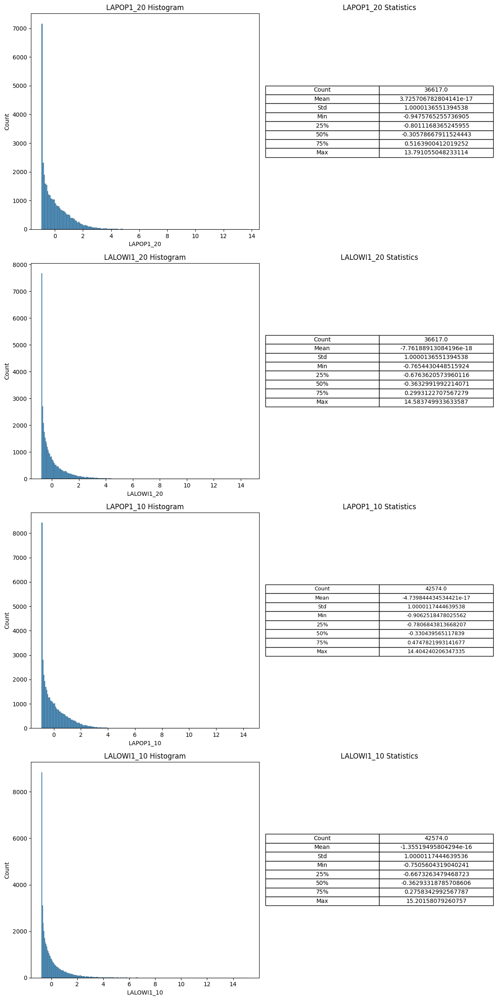

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# List of columns with high missing values
high_missing_cols = ['LAPOP1_20', 'LALOWI1_20', 'LAPOP1_10', 'LALOWI1_10']

# Create subplots
num_cols = 2  # One for histograms, one for statistics
num_rows = len(high_missing_cols)

# Set up the figure and axes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 6 * num_rows))

# Loop through columns
for i, col in enumerate(high_missing_cols):
    # Get non-missing data for the column
    non_missing_data = dF[col].dropna()
    
    # Plot histogram distribution
    sns.histplot(non_missing_data, ax=axes[i, 0])
    axes[i, 0].set_title(f"{col} Histogram")
    
    # Calculate summary statistics
    describe_table = non_missing_data.describe().reset_index()
    describe_table.columns = ["Stat", "Value"]
    
    # Create a table with text labels for each statistic
    stats_labels = ["Count", "Mean", "Std", "Min", "25%", "50%", "75%", "Max"]
    describe_table["Stat"] = stats_labels
    
    # Plot the summary statistics as a plain table
    table = axes[i, 1].table(cellText=describe_table.values, colLabels=None, cellLoc='center', loc='center')
    axes[i, 1].set_title(f"{col} Statistics")
    
    # Remove axis labels and ticks for aesthetics
    axes[i, 1].axis("off")
    print()

# Adjust subplot layout
plt.tight_layout()

# Show the plots
plt.show()


### I decide to delete the columns
#### The easiest and most extreme case where you would not hesitate to delete columns based on their statistics and histograms is when:

#### All Missing Values: The columns have a very high percentage of missing values, ideally close to 100%. In such cases, these columns provide no useful information for analysis, and retaining them would introduce unnecessary complexity.

#### Zero Variance: The columns have no variability; all values are identical. This would be evident from a histogram showing a single bar or spike at one value and summary statistics like mean, median, and mode all being the same. Such columns do not contribute any discriminative power to clustering.

#### Uninformative Distribution: The histogram displays a flat or uniform distribution, indicating that values are spread across a wide range without any apparent pattern or clustering. The summary statistics show no meaningful patterns or deviations from the mean.

#### Domain Irrelevance: You have domain knowledge that confirms the columns are irrelevant to your analysis and do not align with the problem's context.

#### In these extreme cases, retaining such columns would not add any value to your analysis and would likely introduce noise. Therefore, it would be a clear decision to delete them to simplify your dataset and improve the performance of clustering algorithms.

In [17]:
dF.shape

(72531, 92)

In [18]:
fiftyPerc_missing_cols = ['LAPOP1_20', 'LALOWI1_20', 'LAPOP1_10', 'LALOWI1_10']


dF = dF.drop(columns=fiftyPerc_missing_cols)
dF.shape

(72531, 88)

In [28]:
pca = PCA(n_components=0.90)
new_dF=pca.fit_transform(dF)
new_dF.shape

(72531, 21)

In [29]:
new_dF = pd.DataFrame(new_dF)
type(new_dF)

pandas.core.frame.DataFrame

In [30]:
new_dF.columns

RangeIndex(start=0, stop=21, step=1)

In [31]:
new_dF.head

<bound method NDFrame.head of               0          1          2          3          4          5   \
0       0.930473  -2.391080  -2.012683  -2.317661   2.528076  -0.362256   
1       2.188041   3.428055  -3.741309  -3.850736   2.281877  -0.883205   
2       0.437174  -0.533159  -0.225482  -2.129875   0.557841  -0.023648   
3       0.257587  -2.117794   1.203385  -2.545758  -0.520994   0.670773   
4       4.749952   0.436767   5.438826  -1.713769  -5.615441   1.776619   
5       5.435924   1.358242  -2.202060  -2.070537   1.409753  -0.752920   
6       1.475955   2.708974  -1.851799  -1.886273   1.249342  -0.292963   
7       1.785246  -3.424418  -3.524342   1.150026   0.495420  -0.924992   
8      10.241287  -3.092505   0.817793   3.350359  -7.160343  -0.329526   
9       4.791572  -3.315318  -1.959369   2.372108  -2.253775  -1.150876   
10      3.066567  -1.028791  -4.204171   0.171577   1.430090  -0.814653   
11      6.847359   3.865445  -7.403613  -1.764221  -1.066772  -0.85573

***
# __3. Exploratory Data Analysis (EDA)__
***

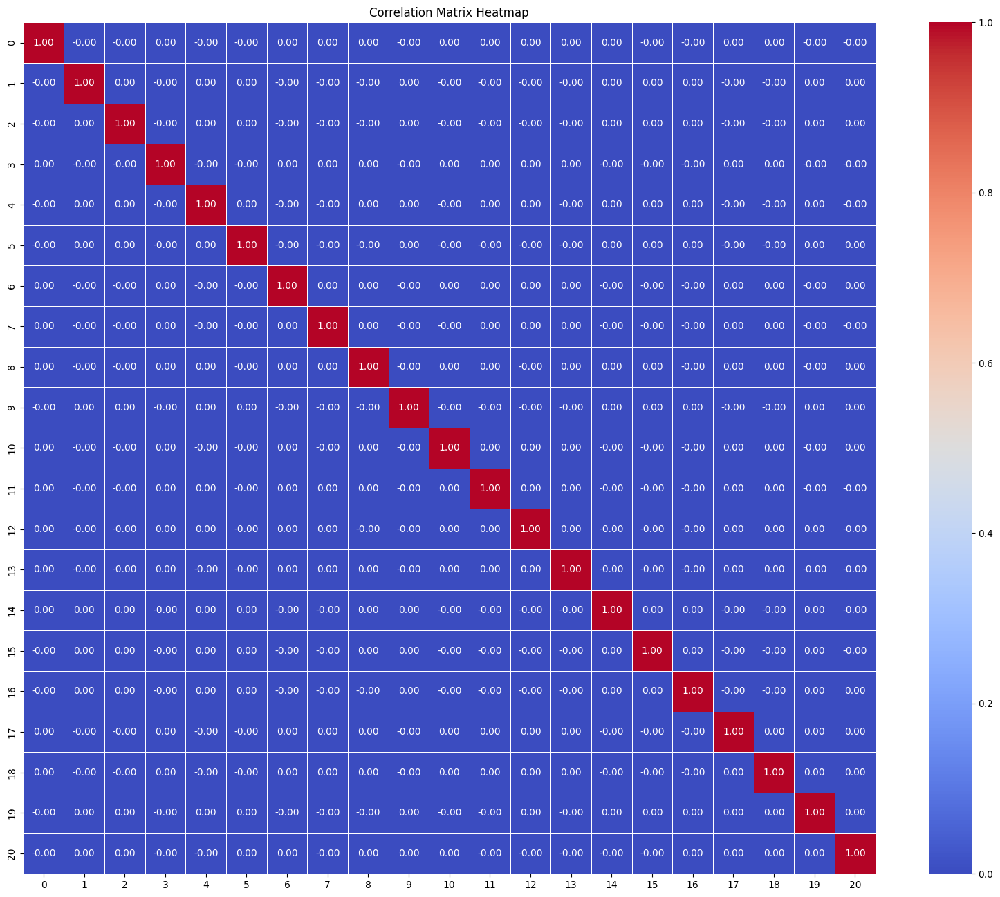

In [36]:
# Create a correlation matrix
correlation_matrix = new_dF.corr()

# Set up the matplotlib figure
plt.figure(figsize=(20, 16))

# Create the correlation heatmap
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", mask=None, linewidths=0.5, square=True)

# Add a title
plt.title("Correlation Matrix Heatmap")

# Show the plot
plt.show()

***
# __4. Pre_processing__
***

***
# __5. Modelling__
***

In [43]:
pca = PCA(n_components=2)
new_dF=pca.fit_transform(dF)
new_dF.shape

(72531, 2)

c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\clus

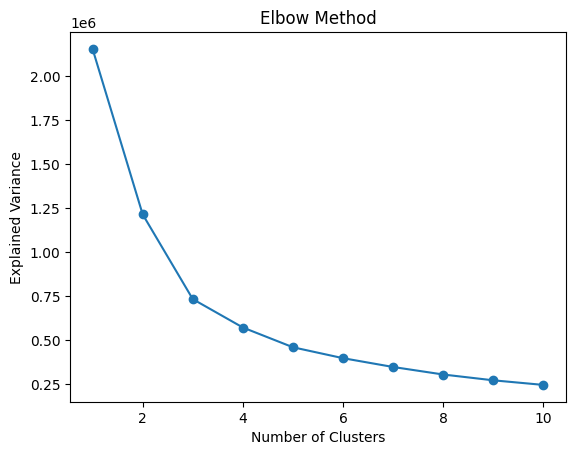

In [44]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Assuming new_dF is your PCA-reduced data
explained_variances = []
for i in range(1, 11):  # Try different numbers of clusters
    kmeans = KMeans(n_clusters=i, random_state=0).fit(new_dF)
    explained_variances.append(kmeans.inertia_)  # Inertia measures how far the points are from cluster centers

plt.plot(range(1, 11), explained_variances, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Explained Variance')
plt.title('Elbow Method')
plt.show()


In [46]:
from sklearn.cluster import KMeans

# Create a K-Means model with k=4 clusters
kmeans = KMeans(n_clusters=4, random_state=42)

# Fit the model to your data
kmeans.fit(new_dF)

# Get cluster labels for each data point
cluster_labels = kmeans.labels_



c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [52]:
plt.scatter(new_dF[:, 0], new_dF[:, 1])

InvalidIndexError: (slice(None, None, None), 0)

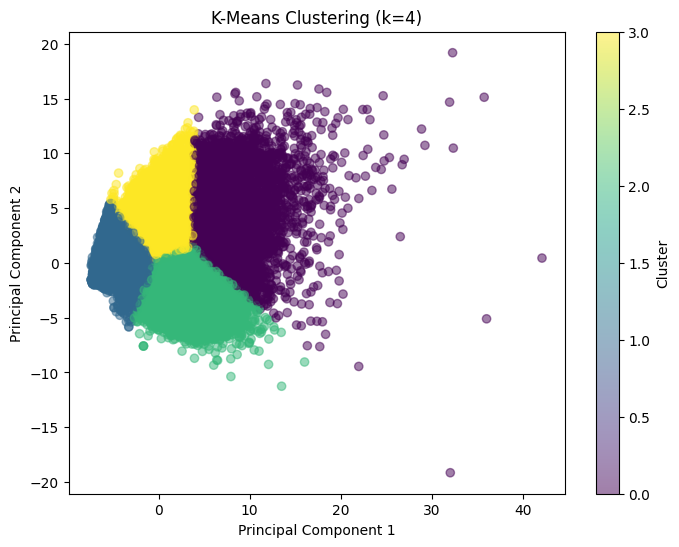

In [47]:
import matplotlib.pyplot as plt

# Create a scatter plot of the clustered data points
plt.figure(figsize=(8, 6))
plt.scatter(new_dF[:, 0], new_dF[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
plt.title('K-Means Clustering (k=4)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar(label='Cluster')
plt.show()


***
# __6. Evaluation__


***

c:\Users\STAFF\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


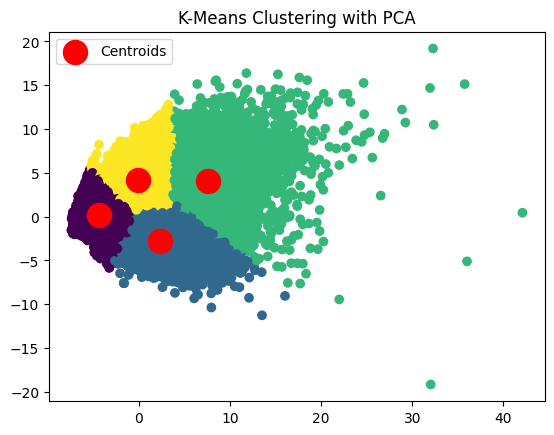

In [49]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Assuming you have 'dF' as your original DataFrame

# Perform PCA
pca = PCA(n_components=2)
new_dF = pca.fit_transform(dF)

# Train K-Means with k=4 clusters
kmeans = KMeans(n_clusters=4)
kmeans.fit(new_dF)

# Add the cluster labels as a new column in your DataFrame
cluster_series = pd.Series(kmeans.labels_, name='Cluster')
new_dF = pd.concat([pd.DataFrame(new_dF, columns=['PC1', 'PC2']), cluster_series], axis=1)

# Calculate the mean of each feature within each cluster
cluster_means = new_dF.groupby('Cluster').mean()

# Plot the scatter plot with color-coded clusters
plt.scatter(new_dF['PC1'], new_dF['PC2'], c=new_dF['Cluster'], cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red', label='Centroids')
plt.legend()
plt.title('K-Means Clustering with PCA')

# Show the plot
plt.show()

# You can now use 'cluster_means' to analyze the characteristics of each cluster.


Silhouette Score: 0.45


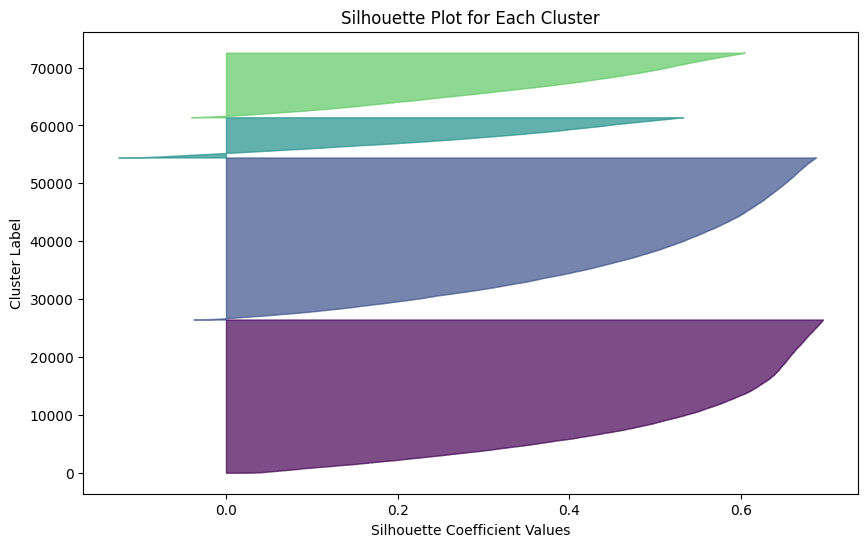

In [50]:
from sklearn.metrics import silhouette_score

# Calculate the silhouette score for your clustered data
silhouette_avg = silhouette_score(new_dF.drop(columns=['Cluster']), kmeans.labels_)
print(f'Silhouette Score: {silhouette_avg:.2f}')

# You can also visualize the silhouette scores for individual data points
from sklearn.metrics import silhouette_samples
import numpy as np

# Calculate silhouette scores for each data point
sample_silhouette_values = silhouette_samples(new_dF.drop(columns=['Cluster']), kmeans.labels_)

# Create a bar plot of silhouette scores for each point
plt.figure(figsize=(10, 6))
y_lower = 10
for i in range(len(cluster_means)):
    ith_cluster_silhouette_values = sample_silhouette_values[kmeans.labels_ == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    color = plt.cm.viridis(float(i) / len(cluster_means))
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)
    y_lower = y_upper + 10

plt.title('Silhouette Plot for Each Cluster')
plt.xlabel('Silhouette Coefficient Values')
plt.ylabel('Cluster Label')
plt.show()

